In [1]:
%run '../dynamo_helper_functions.ipynb'

/tmp/ipykernel_2887011/3777615979.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


['/net/capricorn/home/xing/soh29/.conda/envs/dynamo_06_2024/lib/python3.8/site-packages/dynamo']


package,umap-learn,trimap,tqdm,statsmodels,setuptools,seaborn,scipy,scikit-learn,python-igraph,pynndescent,pre-commit,pandas,numpy,numdifftools,numba,networkx,matplotlib,loompy,hdbscan,dynamo-release,cvxopt,colorcet
version,0.5.6,1.1.4,4.66.4,0.14.1,70.1.0,0.13.2,1.10.1,1.3.2,0.11.5,0.5.8,3.5.0,1.2.0,1.23.0,0.9.41,0.51.2,3.1,3.7.5,3.0.7,0.8.37,1.0.0,1.3.2,3.1.0


# Functions

In [2]:
def rotate_z(x, y, z, theta):
    w = x+1j*y
    return np.real(np.exp(1j*theta)*w), np.imag(np.exp(1j*theta)*w), z

In [22]:
def set_box_color(bp, color, fill_colors):
    plt.setp(bp['boxes'], color=color, linewidth=0.75)
    plt.setp(bp['whiskers'], color=color, linewidth=0.75)
    plt.setp(bp['caps'], color=color, linewidth=0.75)
    plt.setp(bp['medians'], color=color, linewidth=0.75)
    plt.setp(bp['fliers'], color=color, linewidth=0.75)
    colors = ['pink', 'lightblue', 'lightgreen']
    for patch, fill_color in zip(bp['boxes'], fill_colors):
        patch.set_facecolor(fill_color)

# Load libraries

In [5]:
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import anndata as ad
import matplotlib
import plotly.graph_objects as go
import plotly.io as pio
from numpy import pi, sin, cos
import mpl_toolkits.mplot3d.axes3d as p3
import matplotlib.animation as animation
from scipy.interpolate import interp1d
#import helper_functions
from shapely.geometry import MultiPoint
from shapely.geometry import Point
from shapely.geometry import Polygon

In [6]:
doses = ['0', '12', '25', '50', '100', '200', '400', '800']
colors = {'G1.S':'firebrick', 'S':'orange', 'G2':'yellowgreen', 'G2.M':'teal', 'M.G1':'royalblue'}
colors2 = {'G1-S':'firebrick', 'S':'orange', 'G2-M':'yellowgreen', 'M':'teal', 'M-G1':'royalblue'}

In [7]:
cmap = plt.cm.get_cmap("plasma")

In [8]:
dose_dict = {'0':cmap(0), 
             '12':cmap(1),
             '25':cmap(2), 
             '50':cmap(3),
             '100':cmap(4),
             '200':cmap(5), 
             '400':cmap(6), 
             '800':cmap(7)}

In [9]:
dosage_int_dict = {0:0, 
                   12:1,
                   25:2, 
                   50:3,
                   100:4,
                   200:5, 
                   400:6, 
                   800:7}

In [ ]:
# Load data

In [10]:
adata = dyn.read_loom("../../data/static_MCF10A/processed_possorted_genome_bam_RIG79.loom")

In [13]:
temp = np.empty((len(adata.obs),1), dtype=object)
temp.shape
for i in range(len(adata.obs)):
    temp[i] = str(int(float(adata.obs['dosage'][i])))
adata.obs['dosage'] = temp

In [14]:
dyn.pp.recipe_monocle(adata, keep_filtered_genes=True)

|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...


{'filter_bool': None, 'layer': 'all', 'min_cell_s': 89.83, 'min_cell_u': 44.915, 'min_cell_p': 44.915, 'min_avg_exp_s': 0, 'min_avg_exp_u': 0, 'min_avg_exp_p': 0, 'max_avg_exp': inf, 'min_count_s': 0, 'min_count_u': 0, 'min_count_p': 0, 'shared_count': 30}


|-----> calculating size factor...


                             Accession  Chromosome       End     Start Strand  \
BX004987.1           ENSG00000278704.1  GL000009.2     58376     56140      -   
AC145212.1           ENSG00000277400.1  GL000194.1    115018     53590      -   
MAFIP                ENSG00000274847.1  GL000194.1    115055     53594      -   
Y_RNA                ENSG00000277428.1  GL000195.1     37534     37434      -   
AC011043.1           ENSG00000276256.1  GL000195.1     49164     42939      -   
...                                ...         ...       ...       ...    ...   
DPH3P2-1       ENSG00000237040.6_PAR_Y           Y  57062405  57062156      +   
VAMP7-1       ENSG00000124333.16_PAR_Y           Y  57130289  57067865      +   
IL9R-1        ENSG00000124334.17_PAR_Y           Y  57197337  57184101      +   
AJ271736.1-1   ENSG00000270726.6_PAR_Y           Y  57208756  57190738      +   
WASH6P-1      ENSG00000182484.15_PAR_Y           Y  57212230  57207346      +   

              nCells  nCoun

|-----> selecting genes...


None
{'min_expr_cells': 0, 'min_expr_avg': 0, 'max_expr_avg': inf, 'svr_gamma': None, 'winsorize': False, 'winsor_perc': (1, 99.5), 'sort_inverse': False}
sort by:  SVR
adata shape:  (8983, 60668)
adata shape:  (8983, 8374)
layer:  X
CM:  (8983, 8374)
CM:  (8983, 8374)
detected_bool:  [ True  True  True ...  True  True  True]
valid CM:  (8983, 8374)
mu:  [0.07739146 0.04695643 0.09673756 ... 0.20505933 0.5155609  0.21146762]
mu shape:  (8374,)
log_m:  [-3.6916819  -4.4125333  -3.36978    ... -2.2858868  -0.95578516
 -2.2414913 ]


|-----> <insert> frac to var in AnnData Object.


sort by:  SVR
adata shape:  (8983, 60668)
adata shape:  (8983, 2000)
layer:  X
CM:  (8983, 2000)
CM:  (8983, 2000)
detected_bool:  [ True  True  True ...  True  True  True]
valid CM:  (8983, 2000)
mu:  [0.1979564  0.14483579 0.04970594 ... 0.19755629 0.13581544 1.3952672 ]
mu shape:  (2000,)
log_m:  [-2.3367455  -2.78751    -4.330438   ... -2.3396642  -2.8802805
  0.48054147]


|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|-----> <insert> pca_fit to uns in AnnData Object.
|-----> <insert> ntr to obs in AnnData Object.
|-----> <insert> ntr to var in AnnData Object.
|-----> cell cycle scoring...
|-----> computing cell phase...
|
|-----> [cell phase estimation] finished [419.7022s]
|-----> <insert> cell_cycle_phase to obs in AnnData Object.
|-----> <insert> cell_cycle_scores to obsm in AnnData Object.
|
|-----> [Cell Cycle Scores Estimation] finished [3.9075s]
|
|-----> [recipe_monocle preprocess] finished [42.5497s]


In [ ]:
sig_EMT_76 = pd.read_excel('gene_lists/signature_EMT_76_genes.xlsx')
rows_to_keep = []
for i in range(sig_EMT_76.shape[0]):
    if sig_EMT_76['GENE'][i] in adata.var_names.tolist():
        rows_to_keep.append(i)

In [17]:
EM_genes = pd.read_excel("gene_lists/Epithelial_mesenchymal_marker_genes.xlsx")
E_genes = np.array(EM_genes[EM_genes['Signature']=='Epi']['Gene Name'])
M_genes = np.array(EM_genes[EM_genes['Signature']=='Mes'].reset_index(drop=True)['Gene Name'])

In [18]:
#Calculating KS Emt Score
all_genes = adata.var.index
E_exp = pd.DataFrame()
for j in range(E_genes.shape[0]):
    if E_genes[j] in all_genes:
        gene_index = all_genes.get_loc(E_genes[j])
        E_exp[E_genes[j]] = adata.X.toarray()[:,gene_index]

M_exp = pd.DataFrame()
for j in range(M_genes.shape[0]):
    if M_genes[j] in all_genes:
        gene_index = all_genes.get_loc(M_genes[j])  
        M_exp[M_genes[j]] = adata.X.toarray()[:,gene_index]

emt_score = KS_emt_score(E_exp, M_exp)
adata.obs['Emt_score_KS'] = emt_score

# EMT score across all tgfb concentrations

([<matplotlib.axis.XTick at 0x7fc4a0dcf8e0>,
 [Text(0, 0, '0'),
  Text(1, 0, '12'),
  Text(2, 0, '25'),
  Text(3, 0, '50'),
  Text(4, 0, '100'),
  Text(5, 0, '200'),
  Text(6, 0, '400'),
  Text(7, 0, '800')])

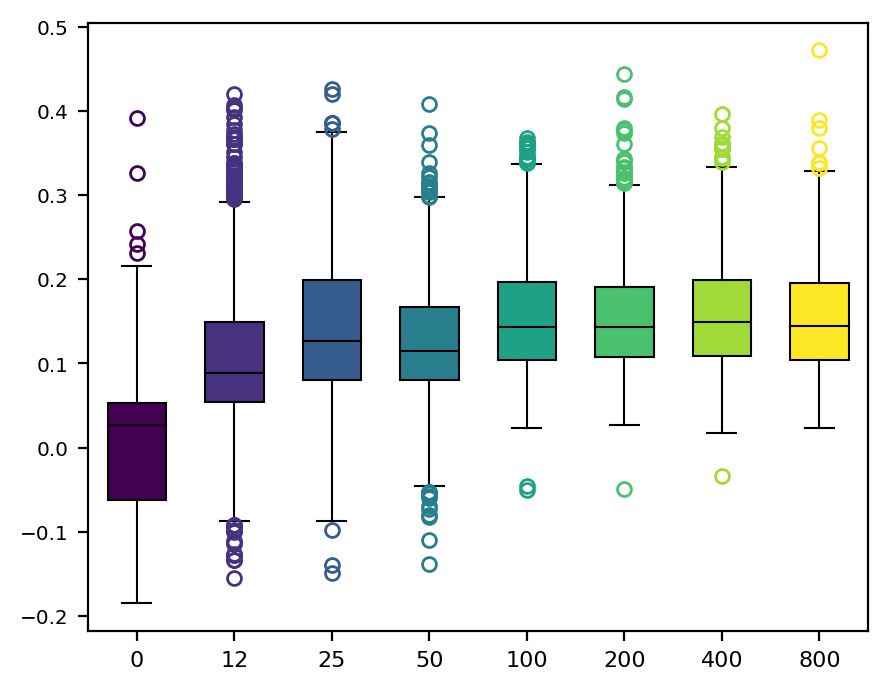

In [23]:
plt.figure(figsize=(5,4))
colors = plt.cm.get_cmap("viridis", len(doses))
for i in range(len(doses)):
    temp = adata[adata.obs['dosage'] == doses[i]]
    bp = plt.boxplot(temp.obs['Emt_score_KS'], positions=[i], widths=0.6, 
                     patch_artist=True,
                     flierprops={'marker': 'o', 'markersize': 5, 'markeredgecolor': colors(i)})
    set_box_color(bp, 'black', [colors(i)])
plt.xticks(np.arange(0,8,1), labels=doses, fontsize=8)
#plt.savefig("../generated_data/KS_emt_score_boxplots.png", dpi=300)

# UMAP 3D

In [47]:
#umap_model = umap.UMAP(n_components=3, min_dist=0.5, n_neighbors=15, random_state=0)

In [48]:
#X_transformed = umap_model.fit_transform(adata.obsm['X_pca'])

In [89]:
#np.save("data/umap_3d_randst_0.npy", X_transformed)

In [11]:
X_transformed = np.load("data/umap_3d_randst_0.npy")

In [12]:
umap_3d_all = pd.DataFrame(X_transformed, columns=['UMAP1','UMAP2','UMAP3'])
umap_3d_all['dose'] = list(adata.obs['dosage'].astype('int64'))
umap_3d_all = umap_3d_all.sort_values(by='dose')
umap_3d_all['dose'] = umap_3d_all['dose'].astype('object')
umap_3d_all['dose_num'] = umap_3d_all['dose'].map(dosage_int_dict)
umap_3d_all['dose_num2'] = umap_3d_all['dose_num'].map(dose_dict)
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='dose_num',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=3,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="All tgfb doses", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  height=1000, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),
                  paper_bgcolor='white',
                  scene= scenes)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/all_doses.html")

In [100]:
umap_3d_all = pd.DataFrame(X_transformed, columns=['UMAP1','UMAP2','UMAP3'])
umap_3d_all['dose'] = list(adata.obs['dosage'].astype('int64'))
umap_3d_all = umap_3d_all.sort_values(by='dose')
umap_3d_all['dose'] = umap_3d_all['dose'].astype('object')
umap_3d_all['dose_num'] = umap_3d_all['dose'].map(dosage_int_dict)
umap_3d_all['dose_num2'] = umap_3d_all['dose_num'].map(dose_dict)
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='dose_num',
                    height=2000,
                    color_continuous_scale='rainbow_r'
                   )
fig.update_traces(marker=dict(size=3,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="All tgfb doses", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  height=1000, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),
                  paper_bgcolor='white',
                  scene= scenes)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/all_doses_rainbow.html")

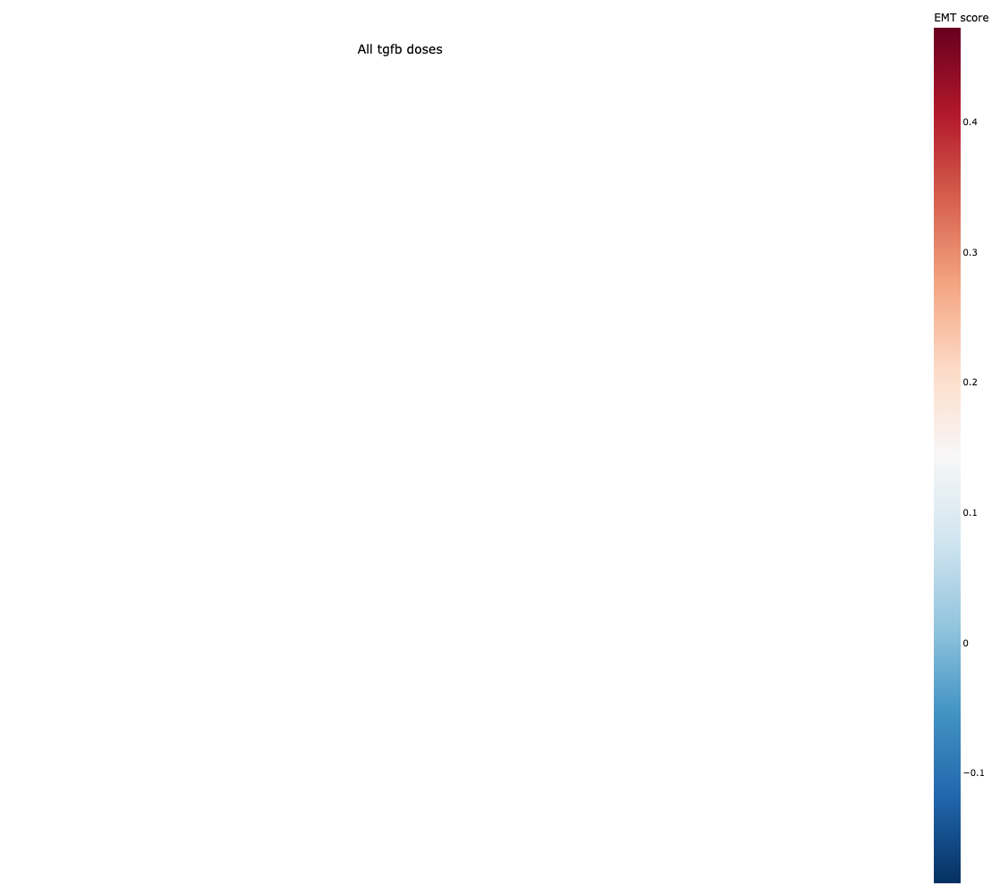

In [19]:
umap_3d_all = pd.DataFrame(X_transformed, columns=['UMAP1','UMAP2','UMAP3'])
umap_3d_all['EMT score'] = adata.obs['Emt_score_KS'].reset_index(drop=True)
umap_3d_all['dose'] = list(adata.obs['dosage'].astype('int64'))
umap_3d_all = umap_3d_all.sort_values(by='dose')
umap_3d_all['dose'] = umap_3d_all['dose'].astype('object')
umap_3d_all['dose_num'] = umap_3d_all['dose'].map(dosage_int_dict)
umap_3d_all['dose_num2'] = umap_3d_all['dose_num'].map(dose_dict)
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='EMT score',
                    height=2000,
                    color_continuous_scale='RdBu_r'
                   )
fig.update_traces(marker=dict(size=3,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="All tgfb doses", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  height=1000, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),
                  paper_bgcolor='white',
                  scene= scenes)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/all_doses_EMT.html")

In [108]:
X_data = adata.X.toarray()
gene = 'FN1'
gene_index = adata.var.index.get_loc(gene)
umap_3d_all = pd.DataFrame(X_transformed, columns=['UMAP1','UMAP2','UMAP3'])
umap_3d_all['EMT score'] = adata.obs['Emt_score_KS'].reset_index(drop=True)
umap_3d_all['FN1'] = X_data[:,gene_index]
umap_3d_all['dose'] = list(adata.obs['dosage'].astype('int64'))
umap_3d_all = umap_3d_all.sort_values(by='dose')
umap_3d_all['dose'] = umap_3d_all['dose'].astype('object')
umap_3d_all['dose_num'] = umap_3d_all['dose'].map(dosage_int_dict)
umap_3d_all['dose_num2'] = umap_3d_all['dose_num'].map(dose_dict)
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='FN1',
                    height=2000,
                    color_continuous_scale='RdBu_r'
                   )
fig.update_traces(marker=dict(size=3,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="All tgfb doses", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  height=1000, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),
                  paper_bgcolor='white',
                  scene= scenes)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/all_doses_FN1.html")

In [107]:
X_data = adata.X.toarray()
gene = 'VIM'
gene_index = adata.var.index.get_loc(gene)
umap_3d_all = pd.DataFrame(X_transformed, columns=['UMAP1','UMAP2','UMAP3'])
umap_3d_all['EMT score'] = adata.obs['Emt_score_KS'].reset_index(drop=True)
umap_3d_all[gene] = X_data[:,gene_index]
umap_3d_all['dose'] = list(adata.obs['dosage'].astype('int64'))
umap_3d_all = umap_3d_all.sort_values(by='dose')
umap_3d_all['dose'] = umap_3d_all['dose'].astype('object')
umap_3d_all['dose_num'] = umap_3d_all['dose'].map(dosage_int_dict)
umap_3d_all['dose_num2'] = umap_3d_all['dose_num'].map(dose_dict)
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color=gene,
                    height=2000,
                    color_continuous_scale='RdBu_r'
                   )
fig.update_traces(marker=dict(size=3,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="All tgfb doses", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  height=1000, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),
                  paper_bgcolor='white',
                  scene= scenes)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/all_doses_VIM.html")

In [106]:
X_data = adata.X.toarray()
gene = 'TOP2A'
gene_index = adata.var.index.get_loc(gene)
umap_3d_all = pd.DataFrame(X_transformed, columns=['UMAP1','UMAP2','UMAP3'])
umap_3d_all['EMT score'] = adata.obs['Emt_score_KS'].reset_index(drop=True)
umap_3d_all[gene] = X_data[:,gene_index]
umap_3d_all['dose'] = list(adata.obs['dosage'].astype('int64'))
umap_3d_all = umap_3d_all.sort_values(by='dose')
umap_3d_all['dose'] = umap_3d_all['dose'].astype('object')
umap_3d_all['dose_num'] = umap_3d_all['dose'].map(dosage_int_dict)
umap_3d_all['dose_num2'] = umap_3d_all['dose_num'].map(dose_dict)
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color=gene,
                    height=2000,
                    color_continuous_scale='RdBu_r'
                   )
fig.update_traces(marker=dict(size=3,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="All tgfb doses", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  height=1000, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),
                  paper_bgcolor='white',
                  scene= scenes)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/all_doses_TOP2A.html")

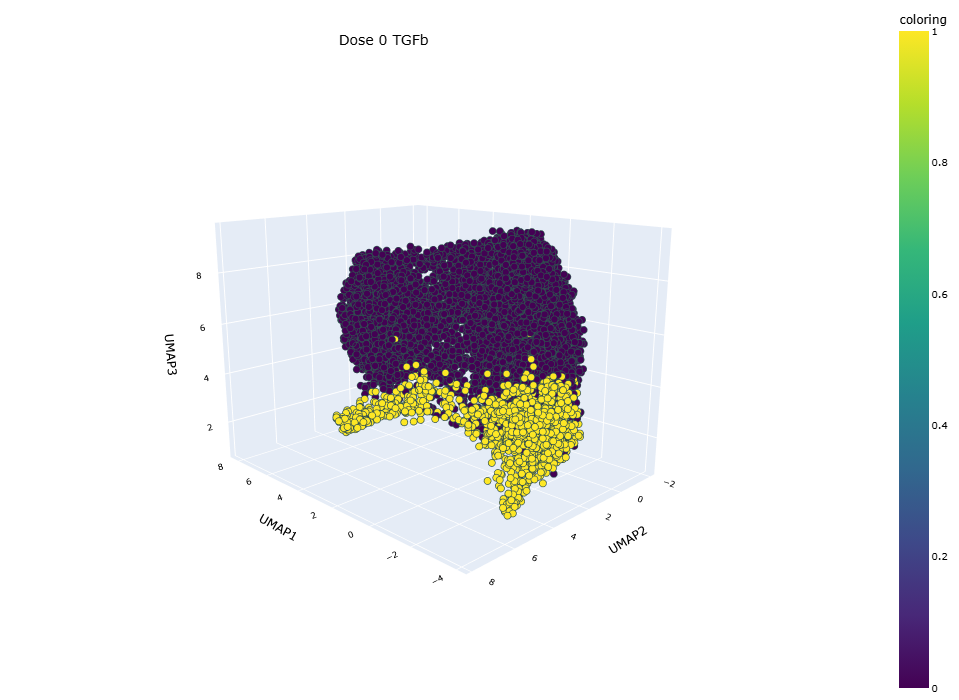

In [61]:
num = 0
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/untreated_dose.html")

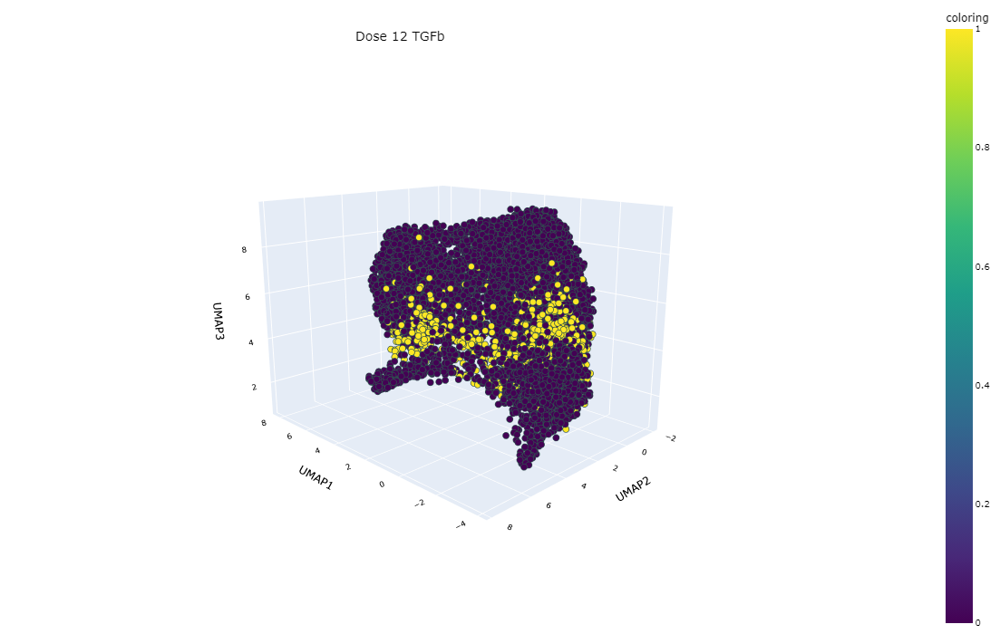

In [62]:
num = 12
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/12_dose.html")

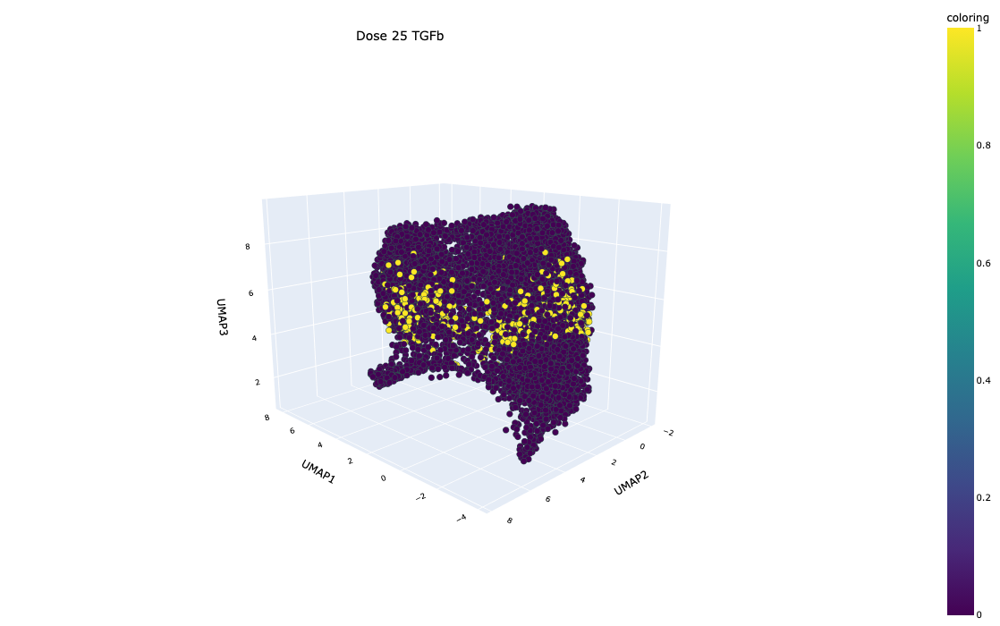

In [63]:
num = 25
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/25_dose.html")

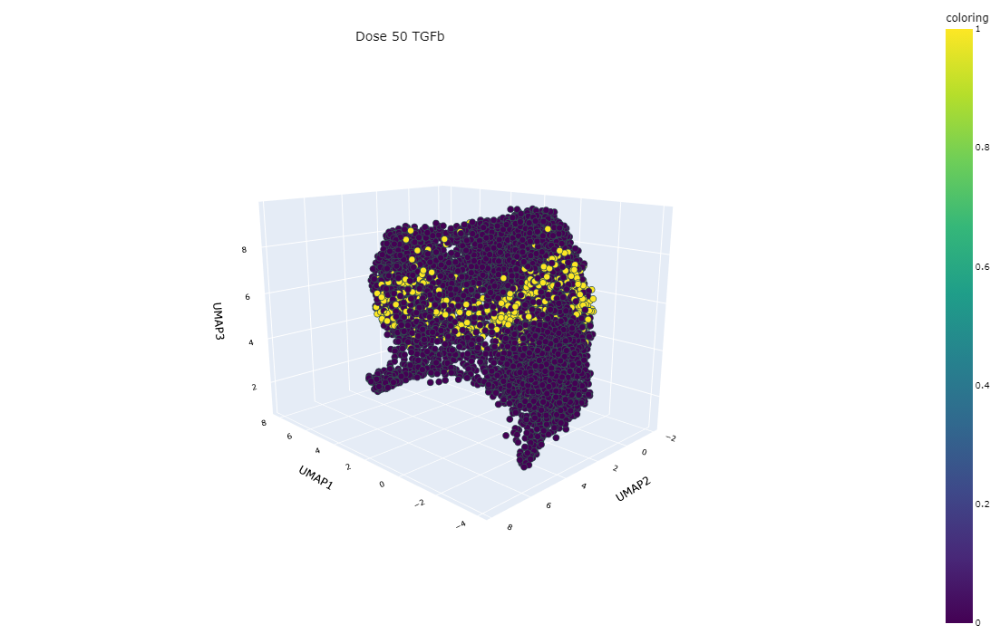

In [64]:
num = 50
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/50_dose.html")

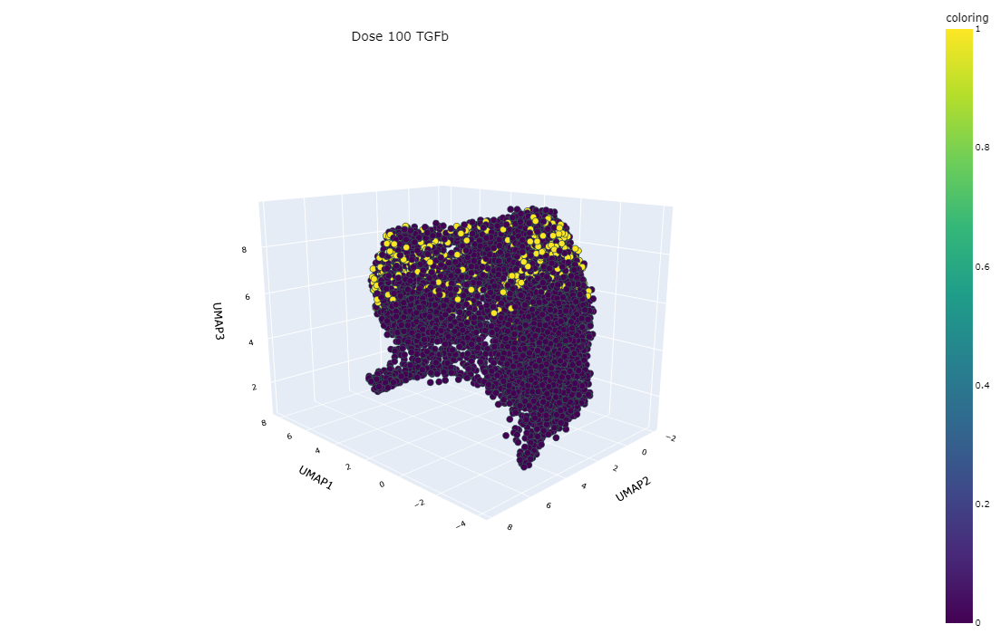

In [65]:
num = 100
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/100_dose.html")

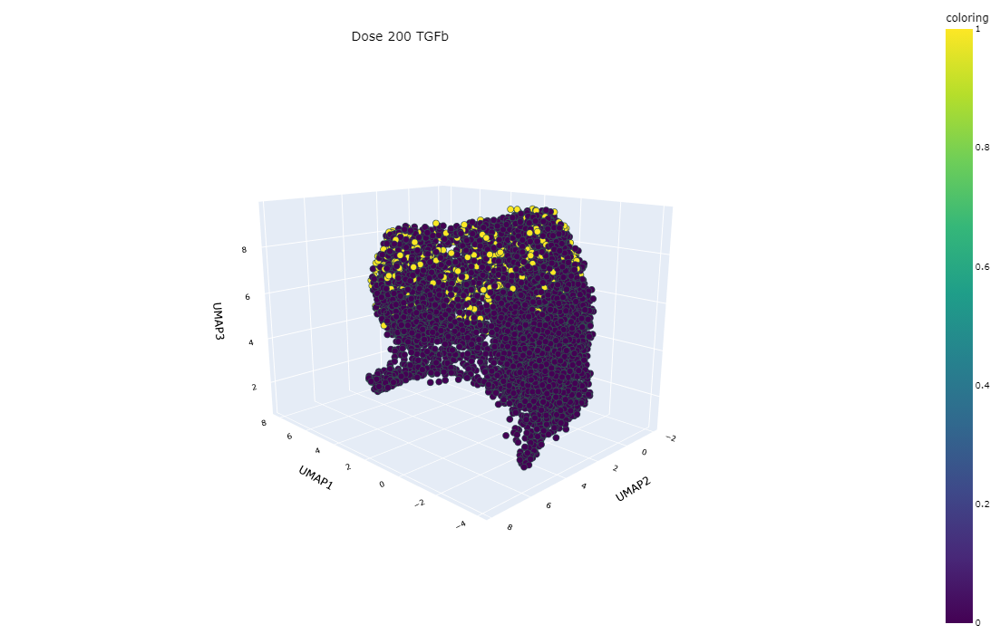

In [66]:
num = 200
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/200_dose.html")

In [67]:
num = 400
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/400_dose.html")

In [68]:
num = 800
temp = np.repeat(0, umap_3d_all.shape[0])
temp[umap_3d_all['dose'] == num] = 1
umap_3d_all['coloring'] = temp
fig = px.scatter_3d(umap_3d_all, 
                    x='UMAP1', 
                    y='UMAP2', 
                    z='UMAP3',
                    size=np.repeat(3, umap_3d_all.shape[0]),
                    color='coloring',
                    height=2000,
                    color_continuous_scale='viridis'
                   )
fig.update_traces(marker=dict(size=4,
                              #alpha=0.75,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
scenes = dict(camera_eye=dict(x = -2,
                              y = 2,
                              z = 0.75))
fig.update_layout(title_text="Dose " + str(num) + " TGFb", title_x=0.4, title_y=0.95,
                  font_size=10, font_color="black",
                  #width=800, 
                  height=700, #autosize=True, 
                  margin=dict(t=2, r=2, b=2, l=2),  #IMPORTANT to set only 2 pixels margin because 
                                                    #otherwise around each png there is a two big white space
                  paper_bgcolor='white',
                  scene= scenes
)
fig.show()
#fig.write_html("../plots/3d_UMAPS/version1/800_dose.html")